In [405]:
import json
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
from google.cloud import vision
from google.cloud.vision import types 
import io
from IPython.display import display # to display images
from google.protobuf.json_format import MessageToJson
from google.protobuf.json_format import MessageToDict
import os
import math
client = vision.ImageAnnotatorClient()
import itertools
import re
import dateparser
import datetime
%matplotlib inline

In [239]:
def get_ocr(image):
    image = types.Image(content=image)
    res = client.text_detection(image)
    return MessageToDict(res)

def get_paths_for_folder(folder):
    for f in os.listdir(folder):
        yield os.path.join(folder, f)
        
def read_image(path):
    with open(path, 'rb') as image_file:
        return image_file.read()

def draw_receipt_bbox(path, results):
    data = results[path]
    img = Image.open(path)
    draw = ImageDraw.Draw(img) 
    vertices = data['textAnnotations'][0]['boundingPoly']['vertices']
    x1, y1 = vertices[0]["x"], vertices[0]["y"]
    x2, y2 = vertices[1]["x"], vertices[1]["y"]
    x3, y3 = vertices[2]["x"], vertices[2]["y"]
    x4, y4 = vertices[3]["x"], vertices[3]["y"]
    draw.polygon([x1,y2, x2,y2, x3,y3, x4, y4], outline="red")
    return img

def draw_word_bbox(path, results):
    img = Image.open(path)
    data = results[path]
    return draw_word_bbox2(img, data)

def draw_word_bbox2(img, data):
    draw = ImageDraw.Draw(img) 
    words = data['textAnnotations'][1:]
    for word in words:
        vertices = word['boundingPoly']['vertices']
        x1, y1 = vertices[0].get('x', 0), vertices[0].get('y', 0)
        x2, y2 = vertices[1].get('x', 0), vertices[1].get('y', 0)
        x3, y3 = vertices[2].get('x', 0), vertices[2].get('y', 0)
        x4, y4 = vertices[3].get('x', 0), vertices[3].get('y', 0)
        draw.polygon([x1,y2, x2,y2, x3,y3, x4, y4], outline="red")
    return img 

def crop_image(path, data):
    img = Image.open(path)
    draw = ImageDraw.Draw(img) 
    vertices = data['textAnnotations'][0]['boundingPoly']['vertices']
    x1, y1 = vertices[0]["x"], vertices[0]["y"]
    x2, y2 = vertices[1]["x"], vertices[1]["y"]
    x3, y3 = vertices[2]["x"], vertices[2]["y"]
    x4, y4 = vertices[3]["x"], vertices[3]["y"]
    top = min(y1, y2, y3, y4)
    left = min(x1, x2, x3, x4)
    bottom = max(y1, y2, y3, y4)
    right = max(x1, x2, x3, x4)
    img = img.crop((left, top, right, bottom))
    return img



In [403]:
images = list(get_paths_for_folder("test"))

In [14]:
results = {}
for f in images:
    img = read_image(f)
    results[f] = get_ocr(img)

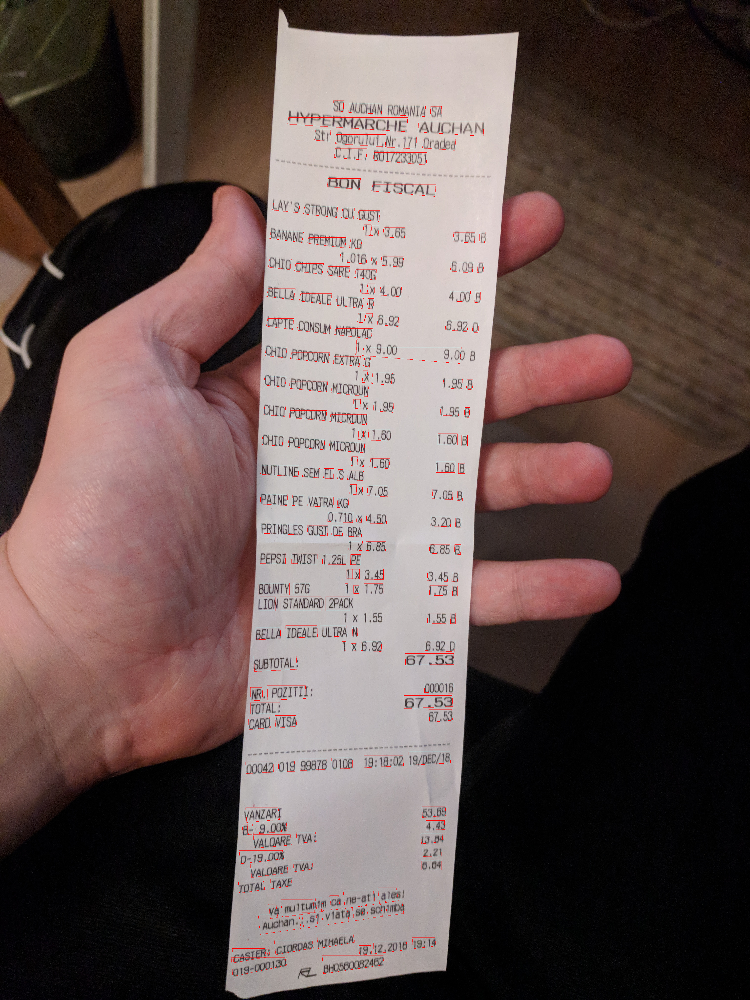

In [25]:
draw_word_bbox(images[3], results)

In [165]:
crop_results = {}
crop_images = {}
for f in images:
    crp = crop_image(f, results[f])
    crop_images[f] = crp
    imgByteArr = io.BytesIO()
    crp.save(imgByteArr, format='jpeg')
    imgByteArr = imgByteArr.getvalue()
    crop_results[f] = get_ocr(imgByteArr)


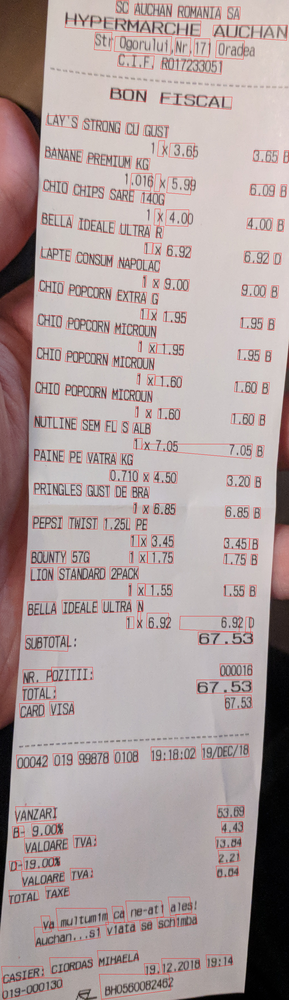

In [46]:
draw_word_bbox2(crop_images[images[3]], crop_results[images[3]])

In [166]:
polys = crop_results[images[2]]['textAnnotations'][1:]
polys

[{'description': 'SC',
  'boundingPoly': {'vertices': [{'x': 352, 'y': 1},
    {'x': 424, 'y': 4},
    {'x': 421, 'y': 69},
    {'x': 349, 'y': 66}]}},
 {'description': 'AUCHAN',
  'boundingPoly': {'vertices': [{'x': 460, 'y': 10},
    {'x': 669, 'y': 19},
    {'x': 666, 'y': 84},
    {'x': 457, 'y': 75}]}},
 {'description': 'ROMANIA',
  'boundingPoly': {'vertices': [{'x': 700, 'y': 17},
    {'x': 945, 'y': 28},
    {'x': 942, 'y': 93},
    {'x': 697, 'y': 82}]}},
 {'description': 'SA',
  'boundingPoly': {'vertices': [{'x': 977, 'y': 22},
    {'x': 1047, 'y': 25},
    {'x': 1044, 'y': 89},
    {'x': 974, 'y': 86}]}},
 {'description': 'HYPERMARCHE',
  'boundingPoly': {'vertices': [{'x': 65, 'y': 65},
    {'x': 841, 'y': 99},
    {'x': 837, 'y': 190},
    {'x': 61, 'y': 156}]}},
 {'description': 'AUCHAN',
  'boundingPoly': {'vertices': [{'x': 914, 'y': 97},
    {'x': 1320, 'y': 115},
    {'x': 1316, 'y': 201},
    {'x': 910, 'y': 183}]}},
 {'description': 'Str',
  'boundingPoly': {'verti

In [242]:
def search_nearest_sum(i, polys):
    coords = polys[i]
    print(coords)
    
#search_nearest_sum(15, polys)

def search_nearest(j, polys, excepts=[]):
    """Get poly which has the nearest corner to a corner of this poly"""
    coords = get_coords(polys[j])
    closest = None
    closest_dist = 10000000
    closest_idx = -1
    for i, p in enumerate(polys):
        d = get_distance(coords, get_coords(p))
        if d < closest_dist and i != j and i not in excepts:
            closest = p
            closest_dist = d
            closest_idx = i
    print(closest)
    return closest_idx
        
        

def get_distance(poly1, poly2):
    dist = 1000000
    for x1, y1 in poly1:
        for x2, y2 in poly2:
            d = math.sqrt((x2-x1)**2+(y2-y1)**2)
            if d < dist:
                dist = d
    return dist
                

def get_coords(poly):
    vertices = poly['boundingPoly']['vertices']
    x1, y1 = vertices[0].get('x', 0), vertices[0].get('y', 0)
    x2, y2 = vertices[1].get('x', 0), vertices[1].get('y', 0)
    x3, y3 = vertices[2].get('x', 0), vertices[2].get('y', 0)
    x4, y4 = vertices[3].get('x', 0), vertices[3].get('y', 0)
    return [(x1, y1), (x2, y2), (x3, y3), (x4, y4)]

# search_nearest(15, polys), search_nearest(16, polys, [15]),search_nearest(17, polys, [16]), search_nearest(18, polys, [17]),\
# search_nearest(19, polys, [18])

In [55]:
for i, p in enumerate(polys):
    if p['description']=="3.65":
        print(i)

20
27


In [56]:
polys[27]

{'description': '3.65',
 'boundingPoly': {'vertices': [{'x': 904, 'y': 526},
   {'x': 991, 'y': 534},
   {'x': 987, 'y': 578},
   {'x': 900, 'y': 571}]}}

In [57]:
polys[15]

{'description': "LAY'S",
 'boundingPoly': {'vertices': [{'x': 168, 'y': 398},
   {'x': 278, 'y': 410},
   {'x': 274, 'y': 455},
   {'x': 163, 'y': 443}]}}

In [243]:
def get_center(poly):
    vertices = poly['boundingPoly']['vertices']
    x1, y1 = vertices[0].get('x', 0), vertices[0].get('y', 0)
    x2, y2 = vertices[1].get('x', 0), vertices[1].get('y', 0)
    x3, y3 = vertices[2].get('x', 0), vertices[2].get('y', 0)
    x4, y4 = vertices[3].get('x', 0), vertices[3].get('y', 0)
    
    return (x1+x3)/2, (y1+y3)/2

def get_items(shape, polys):
    y_min = get_antet_end(shape, polys)[1]
    y_max = get_total(shape, polys)[1]
    x_min = 0
    x_max = shape[0] - 150
    for p in polys:
        xc, yc = get_center(p)
        if not (x_min < xc < x_max) or not (y_min < yc < y_max):
            continue
        print(p['description'])

def get_total(shape,polys):
    for p in polys:
        if "TOTAL" in p['description']:
            return get_center(p)
    return shape[0], shape[1] - 1000

def get_antet_end(shape, polys):
    y_max = 250
    for p in polys:
        if "fiscal" in p['description'].lower() or "c.i.f" in p['description'].lower():
            y_max = max(get_center(p)[1], y_max)
    return 0, y_max

In [167]:
get_items(crop_images[images[2]].size, polys)

PALNIE
PLASTIC
15CM
SALAM
NOBIL
BANAT
BU
CASEROLA
TONELI
10
0
POUCE
FORMA
10
CUBUR
1
x
2.70
1
x
32.10
1
x
11.50
1
x
2.90
2.70
32.10
11.50
2.90
49.20


In [244]:
def get_line(poly1, poly2):
    xc1, yc1 = get_center(poly1)
    xc2, yc2 = get_center(poly2)
    
    if xc2 - xc1 == 0:
        return 0, yc1
    m = (yc2-yc1)/(xc2-xc1)
    b = yc1 - m * xc1
    return m,b

In [245]:
def get_all_lines(polys):
    lines = {}
    angle_min = math.tan(-0.15) # Roughly 15 degress
    angle_max = math.tan(0.15)
    for i, p1 in enumerate(polys):
        for j, p2 in enumerate(polys):
            if i == j:
                continue
            line = get_line(p1, p2)
            dist = get_distance(get_coords(p1), get_coords(p2))
            if angle_min < line[0] < angle_max and dist < 100:
                lines[(i,j)] = line
    return lines

In [149]:
sorted(lines.values(), key=lambda x:x[0])

[(-0.1467065868263473, 3464.1167664670656),
 (-0.1467065868263473, 3464.1167664670656),
 (-0.14482758620689656, 3361.6655172413793),
 (-0.14482758620689656, 3361.6655172413793),
 (-0.1388888888888889, 3305.9583333333335),
 (-0.1388888888888889, 3305.9583333333335),
 (-0.13829787234042554, 3305.654255319149),
 (-0.13829787234042554, 3305.654255319149),
 (-0.13807531380753138, 3195.73640167364),
 (-0.13807531380753138, 3195.73640167364),
 (-0.13513513513513514, 3304.027027027027),
 (-0.13513513513513514, 3304.027027027027),
 (-0.13494809688581316, 3356.538062283737),
 (-0.13494809688581316, 3356.538062283737),
 (-0.1328125, 3303.34765625),
 (-0.1328125, 3303.34765625),
 (-0.12962962962962962, 3352.675925925926),
 (-0.12962962962962962, 3352.675925925926),
 (-0.12840466926070038, 3302.058365758755),
 (-0.12840466926070038, 3302.058365758755),
 (-0.12773722627737227, 3140.043795620438),
 (-0.12773722627737227, 3140.043795620438),
 (-0.125, 3349.9375),
 (-0.125, 3349.9375),
 (-0.12043795620

In [169]:
average_slope = sum(x[0] for x in lines.values())/len(lines)

In [170]:
filtered_lines = {k:v for k,v in lines.items() if abs(v[0] - average_slope) < 0.05}

In [246]:
def draw_lines(img, lines):
    img = img.copy()
    draw = ImageDraw.Draw(img) 
    xmax = img.size[0]-10
    for line in lines:
        p1 = line[0]*10+line[1]
        p2 = line[0]*xmax+line[1]
        draw.line([10, p1, xmax, p2])
    return img 

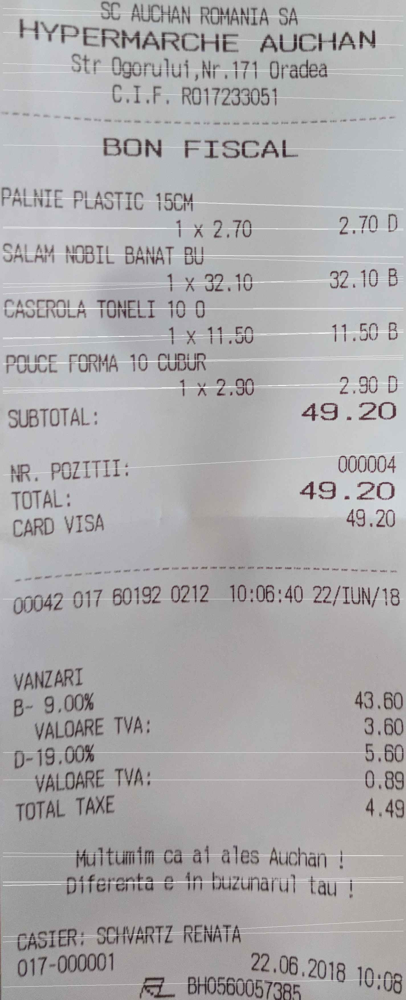

In [185]:
draw_lines(crop_images[images[2]], filtered_lines.values())

In [247]:
def group_lines(lines):
    groups = []
    group = []
    last_y = 0
    for i, line in enumerate(sorted(lines.values(), key=lambda x:x[1])):
        m, b = line
        if abs(b - last_y) > 15:
            groups.append(group)
            last_y = b
            group = []
        group.append((m,b))
    groups.append(group)
    return  groups 

In [248]:
def get_main_lines(groups):
    main_lines = []
    for g in groups:
        if len(g):
            avg_m = sum(x[0] for x in g)/len(g)
            avg_b = sum(x[1] for x in g)/len(g)
            main_lines.append((avg_m, avg_b))
    return main_lines

In [189]:
groups, main_lines

([[],
  [(0.031007751937984496, 29.54263565891473),
   (0.031007751937984496, 29.54263565891473)],
  [(0.002638522427440633, 52.83377308707124),
   (0.002638522427440633, 52.83377308707124)],
  [(0.03237951807228916, 112.89683734939759),
   (0.03237951807228916, 112.8968373493976)],
  [(0.031007751937984496, 221.97674418604652),
   (0.031007751937984496, 221.97674418604652)],
  [(-0.010438413361169102, 255.42379958246346),
   (-0.010438413361169102, 255.42379958246346)],
  [(0.027375201288244767, 314.9903381642512),
   (0.027375201288244767, 314.9903381642512)],
  [(0.013054830287206266, 508.4556135770235),
   (0.013054830287206266, 508.4556135770235)],
  [(0.034026465028355386, 687.6209829867674),
   (0.034026465028355386, 687.6209829867674),
   (0.029978586723768737, 689.1531049250535),
   (0.029978586723768737, 689.1531049250535)],
  [(0.00796812749003984, 795.4980079681275),
   (0.00796812749003984, 795.4980079681275),
   (0.005763688760806916, 797.2968299711815),
   (0.00576368876

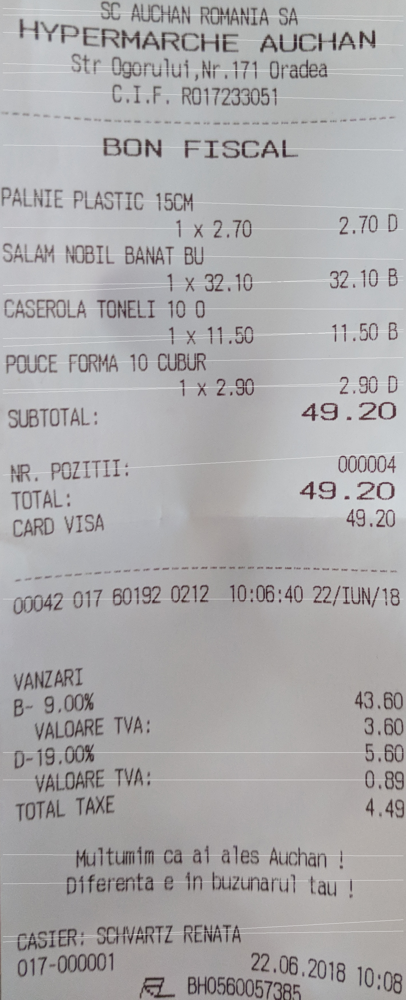

In [190]:
draw_lines(crop_images[images[2]], main_lines)

In [249]:
def distance_from_line(point, line):
    return abs(line[1] + line[0]*point[0] - point[1])/math.sqrt(1+line[0]**2)

In [250]:
def get_words(polys, main_lines):
    words = []
    remaining_polys = polys.copy()
    for line in main_lines:
        current_line = []
        new_polys = []
        for p in remaining_polys:
            if distance_from_line(get_center(p), line) < 10:
                current_line.append(p)
            else:
                new_polys.append(p)
        remaining_polys = new_polys
        # Assumption: the words are sorted by x
        if not current_line:
            continue
        line_group = [current_line[0]]
        prev_x = 0
        for word in current_line[1:]:
            if get_distance(get_coords(line_group[-1]), get_coords(word)) < 80:
                line_group.append(word)
            else:
                words.append([x['description'] for x in line_group])
                line_group = [word]

        words.append([x['description'] for x in line_group])
    return words

In [220]:
words

[['SC', 'AUCHAN', 'ROMANIA', 'SA'],
 ['HYPERMARCHE', 'AUCHAN'],
 ['Str', 'Ogorului,', 'Nr.171', 'Oradea'],
 ['c.1.F.', 'R017233051'],
 ['BON', 'FISCAL'],
 ['PALNIE', 'PLASTIC', '15CM'],
 ['1', 'x', '2.70'],
 ['SALAM', 'NOBIL', 'BANAT', 'BU'],
 ['1', 'x', '32.10'],
 ['32.10'],
 ['B'],
 ['CASEROLA', 'TONELI', '10', '0'],
 ['1', 'x', '11.50'],
 ['11.50', 'B'],
 ['POUCE', 'FORMA', '10', 'CUBUR'],
 ['1', 'x', '2.90'],
 ['2.90', 'D'],
 ['NR.', 'POZITII'],
 ['00042', '017', '60192', '0212', '10:06:40', '22/IU/18'],
 ['5.60'],
 ['%'],
 ['0.89'],
 ['VALOARE'],
 ['Multumim', 'ca', 'ai', 'ales', 'Auchan!'],
 ['Diferenta', 'e', 'in', 'buzunarul'],
 ['SCHVARTZ', 'RENATA'],
 ['CASIER:']]

In [270]:
def pipeline(path):
    img = read_image(path)
    results = get_ocr(img)
    crop = crop_image(path, results)
    imgByteArr = io.BytesIO()
    crop.save(imgByteArr, format='jpeg')
    imgByteArr = imgByteArr.getvalue()
    crop_results = get_ocr(imgByteArr)
    polys = crop_results['textAnnotations'][1:]
    lines = get_all_lines(polys)
    average_slope = sum(x[0] for x in lines.values())/len(lines)
    filtered_lines = {k:v for k,v in lines.items() if abs(v[0] - average_slope) < 0.05}
    grouped_lines = group_lines(filtered_lines)
    main_lines = get_main_lines(grouped_lines)
    words = get_words(polys, main_lines)
    return words

In [394]:
words2 =pipeline(images[2])

In [395]:
words3 = pipeline(images[3])

In [396]:
words1 = pipeline(images[1])

In [397]:
words0 = pipeline(images[0])

In [420]:
def get_word_items(words):
    is_header = True
    items = []
    prices = []

    header_max = 0
    for i, word in enumerate(words[:9]):
        joined = " ".join(word).lower()
        if "c.i.f" in joined or "bon" in joined or "fiscal" in joined or "str " in joined or\
            "bine ati venit" in joined:
            header_max = max(header_max, i)

    company = ""
    address = ""
    for word in words[:header_max]:
        joined = " ".join(word).lower()
        if re.search('S\.?C\.?(.+?)(S.?R.?L.?)|(S[:.,]?A[:.,]?)', joined, re.IGNORECASE):
            company = " ".join(word)
        if "str" in joined or "calea" in joined or "b-dul" in joined or "nr" in joined:
            address = " ".join(word)

    end_min = len(words)
    for i, word in enumerate(words):
        joined = " ".join(word).lower()
        if "total" in joined or "poziti" in joined or "tva" in joined or "numerar" in joined:
            end_min = min(end_min, i)

    data = datetime.date.today().strftime("%Y/%m/%d")
    time = "00:00"
    for word in words[end_min:]:
        joined = " ".join(word).lower()
        match = re.search('\d{2,4}[.\\-/]\w{3}[.\\-/]\d{2,4}', joined, re.IGNORECASE)
        if match:
            data = match.group()
        match = re.search('\d{2,4}[.\\-/]\d{2,4}[.\\-/]\d{2,4}', joined, re.IGNORECASE)
        if match:
            data = match.group()
        match = re.search('\d{2}:\d{2}(:\d{2})?', joined, re.IGNORECASE)
        if match:
            time = match.group()

    date = dateparser.parse(data + " " + time)
    if date:
        date = date.strftime("%Y/%m/%d %H:%M")
    else:
        date = ""
    for i, word in enumerate(words[header_max + 1:end_min]):
        joined = " ".join(word).lower()
        numbers = sum(c.isdigit() for c in joined)
        chars = sum(c.isalpha() for c in joined)
        spaces = sum(c.isspace() for c in joined)
        others = len(joined) - numbers - chars - spaces
        if chars > numbers and len(joined) > 2:
            if "kg" in joined and len(joined) < 4:
                continue
            items.append(joined)
            next_rows = sum(words[i + 1 + header_max + 1:i + 3 + header_max + 1], [])
            print(joined, next_rows)
            nrs = [float(x) for x in next_rows if is_float(x)]
            if nrs:
                price = max(nrs)
            else:
                price = -1
            prices.append({"name": " ".join(word), "price": price})
    return {"company": company, "address": address, "items": prices, "date": date}

    
        
def is_float(string):
    try:
        float(string)
        return True
    except Exception:
        return False

In [418]:
get_word_items(words0)

banane ['CIAO', 'MERE', 'VERZI', '9', '%', '2', '1']
ciao mere verzi 9 % 2 ['1', '3.68']
gatorade cool blue ['1', '3.97', '3.97', 'B']
ciao portocale 12 % 2 ['1', 'x', '4.07', '4.07', 'B']
paine pave feliata 1 ['1', 'x', '3.16', '3.16', 'B']
qilive cablu aliment ['1', 'x', '36.80', '36.80', 'D']
unt 65 % gr covalact 2 ['1', 'x', '6.98', '6.98', 'B']
auchan portocale suc ['1', 'x', '19.99', '19.99', 'B']
zizin apa decarbo 5 ['1', 'x', '3.34', '3.34', 'B']
zizin apa decarbo 5 ['1', 'x', '3.34', '3.34']


{'company': 'SC AUCHAN ROMANIA SA',
 'address': 'Str Ogorului,Nr. 171 Oradea',
 'items': [{'name': 'BANANE', 'price': 9.0},
  {'name': 'CIAO MERE VERZI 9 % 2', 'price': 3.68},
  {'name': 'GATORADE COOL BLUE', 'price': 3.97},
  {'name': 'CIAO PORTOCALE 12 % 2', 'price': 4.07},
  {'name': 'PAINE PAVE FELIATA 1', 'price': 3.16},
  {'name': 'QILIVE CABLU ALIMENT', 'price': 36.8},
  {'name': 'UNT 65 % GR COVALACT 2', 'price': 6.98},
  {'name': 'AUCHAN PORTOCALE SUC', 'price': 19.99},
  {'name': 'ZIZIN APA DECARBO 5', 'price': 3.34},
  {'name': 'ZIZIN APA DECARBO 5', 'price': 3.34}],
 'date': '2018/03/16 11:30'}

In [373]:
img = read_image(images[1])
results = get_ocr(img)
crop = crop_image(path, results)
imgByteArr = io.BytesIO()
crop.save(imgByteArr, format='jpeg')
imgByteArr = imgByteArr.getvalue()
crop_results = get_ocr(imgByteArr)

NameError: name 'path' is not defined

In [324]:
line = " ".join(words0[42])

In [334]:
match = re.search('\d{2,4}[.\\-/]\w{3}[.\\-/]\d{2,4}', line, re.IGNORECASE)  


In [337]:
match.group()

'16/MAR/18'

In [336]:
line

'00042 009 54424 0219 12:01:45 16/MAR/18'

In [344]:
dateparser.parse(match.group()+" 12:01:45")

datetime.datetime(2018, 3, 16, 12, 1, 45)

In [406]:
results = {}
for f in images:
    results[f] = pipeline(f)

In [422]:
for v in results.values():
    print(get_word_items(v))

banane ['CIAO', 'MERE', 'VERZI', '9', '%', '2', '1']
ciao mere verzi 9 % 2 ['1', '3.68']
gatorade cool blue ['1', '3.97', '3.97', 'B']
ciao portocale 12 % 2 ['1', 'x', '4.07', '4.07', 'B']
paine pave feliata 1 ['1', 'x', '3.16', '3.16', 'B']
qilive cablu aliment ['1', 'x', '36.80', '36.80', 'D']
unt 65 % gr covalact 2 ['1', 'x', '6.98', '6.98', 'B']
auchan portocale suc ['1', 'x', '19.99', '19.99', 'B']
zizin apa decarbo 5 ['1', 'x', '3.34', '3.34', 'B']
zizin apa decarbo 5 ['1', 'x', '3.34', '3.34']
{'company': 'SC AUCHAN ROMANIA SA', 'address': 'Str Ogorului,Nr. 171 Oradea', 'items': [{'name': 'BANANE', 'price': 9.0}, {'name': 'CIAO MERE VERZI 9 % 2', 'price': 3.68}, {'name': 'GATORADE COOL BLUE', 'price': 3.97}, {'name': 'CIAO PORTOCALE 12 % 2', 'price': 4.07}, {'name': 'PAINE PAVE FELIATA 1', 'price': 3.16}, {'name': 'QILIVE CABLU ALIMENT', 'price': 36.8}, {'name': 'UNT 65 % GR COVALACT 2', 'price': 6.98}, {'name': 'AUCHAN PORTOCALE SUC', 'price': 19.99}, {'name': 'ZIZIN APA DECARB